# Libraries Installation:

In [ ]:
!pip install geopandas
!pip install haversine
!pip install pykrige

In [2]:
!pip install pysal==2.4.0
!pip install pandas==1.3.3
!pip install numpy==1.21.2
!pip install folium==0.12.1


  Attempting uninstall: fiona
    Found existing installation: Fiona 1.9.1
    Uninstalling Fiona-1.9.1:
      Successfully uninstalled Fiona-1.9.1


You should consider upgrading via the 'c:\users\mija.ubxad\appdata\local\programs\python\python38\python.exe -m pip install --upgrade pip' command.


You should consider upgrading via the 'c:\users\mija.ubxad\appdata\local\programs\python\python38\python.exe -m pip install --upgrade pip' command.


You should consider upgrading via the 'c:\users\mija.ubxad\appdata\local\programs\python\python38\python.exe -m pip install --upgrade pip' command.


You should consider upgrading via the 'c:\users\mija.ubxad\appdata\local\programs\python\python38\python.exe -m pip install --upgrade pip' command.


## Data Loading:

Loading processed dataset taken from ofcom

In [5]:
# Load RSRP Measurement dataset
import pandas as pd

# Specify path of dataset in
dataset_path = r'C:\Learning\Spatial_Data_Science\Project_DS\MSEE19050_CACNUK_MS2\updated_lte.csv'

rsrp_df = pd.read_csv(dataset_path)

# Select only O2 network measurements and their locations
rsrp_df = rsrp_df[['latitude','longitude','rsrp_top1_o2']]

# Drop empty values
rsrp_df.dropna(inplace=True)

In [6]:
# Data is captured while driving so in a certain range value of RSRP measurement 
# remains same (You can observe a very slight change in Latitude and Longitude values for same value of rsrp)
rsrp_df.head()

,latitude,longitude,rsrp_top1_o2
0,51.897719,-0.216234,-57.94
1,51.897674,-0.216179,-57.94
2,51.897673,-0.216179,-57.94
3,51.897622,-0.216116,-57.94
4,51.897515,-0.215988,-57.94


RSRP values are taken via drive testing i am reducing the data points and taking one value of from different intervals so that data processing can be done efficently. 
As the RSRP values are taken along a road so rsrp values remains same in different intervals of distances and i am 
exploiting this fact to reduce my dataset. I am taking taking one point from each interval

In [7]:
# group the data by rsrp_top1_o2 and apply a function to sample a random latitude and longitude value from each grouped interval
sampled_df = rsrp_df.groupby('rsrp_top1_o2').apply(lambda x: x.sample(1))

# reset the index of sampled_df
sampled_df = sampled_df.reset_index(drop=True)

# print the new dataframe
sampled_df.head()

,latitude,longitude,rsrp_top1_o2
0,53.104046,-1.617780,-142.77
1,53.104714,-1.620742,-142.11
2,53.328275,-2.631807,-142.03
3,53.377640,-2.506371,-140.38
4,53.410322,-2.464093,-140.04


In [8]:
# We have location values in the form of longitude and latitude so i am adding geometry column to convert pandas data frame to geodata frame 
# So that we can use it for our spatial anaysis. 
import geopandas as gpd
sampled_gdf = gpd.GeoDataFrame(
    sampled_df, geometry=gpd.points_from_xy(sampled_df.longitude, sampled_df.latitude),
    crs='EPSG:4326'
)
sampled_gdf.head()

,latitude,longitude,rsrp_top1_o2,geometry
0,53.104046,-1.617780,-142.77,POINT (-1.61778 53.10405)
1,53.104714,-1.620742,-142.11,POINT (-1.62074 53.10471)
2,53.328275,-2.631807,-142.03,POINT (-2.63181 53.32827)
3,53.377640,-2.506371,-140.38,POINT (-2.50637 53.37764)
4,53.410322,-2.464093,-140.04,POINT (-2.46409 53.41032)


# Visualization of RSRP measurements 
RSRP measurment loations are plotted on map and as i described above that values are taken along different roads 
this is evident on map

In [11]:
# Lets Visualize the data point on map
import pandas as pd
import folium
from folium.plugins import MarkerCluster

# Creating map centered at the first location in the data
map_center = [sampled_gdf['latitude'][0], sampled_gdf['longitude'][0]]
map_obj = folium.Map(location=map_center)

# Adding markers for each location, with RSRP values displayed when cursor is moved on them
marker_cluster = MarkerCluster(name='RSRP measurements').add_to(map_obj)
for i, row in sampled_gdf.iterrows():
    popup_html = f"O2: {row['rsrp_top1_o2']} dBm<br>"

    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=popup_html,
        tooltip='Click to see rsrp value',
        icon=folium.Icon(color='blue', icon='info-sign')
    ).add_to(marker_cluster)

# Display the map
map_obj


# Visualization of clusters of RSRP measurements
RSRP measurements are ploted in color coded form so that we can get an idea in which areas signal strength is good,normal or weak. Range of RSRP for LTE is -140 to -40

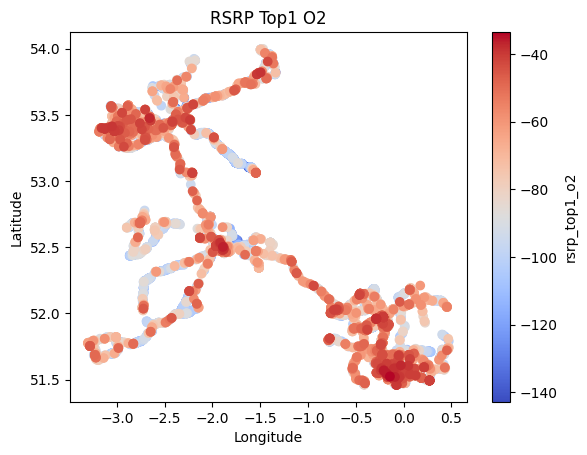

In [13]:
# Now Lets look at the pattern of measurements this will give us an idea how
# Low strength signal measurements and high strength signal measurements are clustered 
import matplotlib.pyplot as plt

# plot longitude and latitude points with color-coded rsrp_top1_o2 values
plt.scatter(sampled_gdf['longitude'], sampled_gdf['latitude'], c=sampled_gdf['rsrp_top1_o2'], cmap='coolwarm')
plt.colorbar(label='rsrp_top1_o2')

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('RSRP Top1 O2')

plt.show()

Now lets see this pattern on map for better understanding 

In [14]:
# To get an idea which regions of UK have better coverage than the others lets 
# look this at the map on which signal strengths are color coded
import folium
from branca.colormap import linear

# creating map which is centered on the UK
uk_map = folium.Map(location=[54.5, -3], zoom_start=6)

# creating color scale for the rsrp_top1_o2 values
colormap = linear.RdYlBu_09.scale(vmin=sampled_gdf['rsrp_top1_o2'].min(), vmax=sampled_gdf['rsrp_top1_o2'].max())

# add a circle marker for each longitude and latitude point with color-coded rsrp_top1_o2 values
for lon, lat, rsrp in zip(sampled_df['longitude'], sampled_df['latitude'], sampled_df['rsrp_top1_o2']):
    folium.CircleMarker([lat, lon], radius=5, fill=True, fill_color=colormap(rsrp), fill_opacity=0.7, color='gray', weight=0.5).add_to(uk_map)

# adding color scale to the map
colormap.caption = 'RSRP Top1 O2'
colormap.add_to(uk_map)

# display the map
uk_map


# OpencelliD Dataset
OpencellID dataset contains locations of cell towers (LTE,UMTS etc) in UK

In [112]:
# Now Lets load dataset which contains locations of cell towers in UK taken from opencellid
cell_tower_db_path = r'C:\Learning\Spatial_Data_Science\Project_DS\MSEE19050_CACNUK_MS2\opencellid_uk_filtered.csv'
cells = pd.read_csv(cell_tower_db_path)

We will only select those cells which come under the region where measurements have been taken 

In [16]:
# Here i have shown the region in which measurements are taken , this will be the area which will under our analysis
# Setting the center of the map
center = [(sampled_df['latitude'].max() + sampled_df['latitude'].min()) / 2, (sampled_df['longitude'].max() + sampled_df['longitude'].min()) / 2]

# Creating a map object
region = folium.Map(location=center, zoom_start=6)

# Creating a rectangle marker to represent the region
folium.Rectangle(bounds=[(sampled_df['latitude'].max(), sampled_df['longitude'].max()), (sampled_df['latitude'].min(), sampled_df['longitude'].min())], fill_opacity=0.2).add_to(region)

# Display the map
region


Filtering cells by radio and mnc (Here I am only intrested in LTE and O2 Network). Secondally I want to extract only those cells from the dataset which are in the region covered by measurements

In [27]:
# latitude and longitude ranges for the RSRP measurements
lat_range = (sampled_df['latitude'].min(), sampled_df['latitude'].max())
lon_range = (sampled_df['longitude'].min(), sampled_df['longitude'].max())

# Filter cells by latitude and longitude ranges 2,11 and 10 are MNCs of O2 network
filtered_cells = cells[(cells['lat'] >= lat_range[0]) & (cells['lat'] <= lat_range[1]) &
                       (cells['lon'] >= lon_range[0]) & (cells['lon'] <= lon_range[1]) &
                       (cells['radio'] == 'LTE') & (cells['mnc'].isin([2, 11, 10]))]

# Selecting only relevant columns
filtered_cells = filtered_cells[['lat', 'lon', 'cell']]

# Rename columns to match sampled_df
filtered_cells.columns = ['latitude', 'longitude', 'cell']

# Reset index
filtered_cells = filtered_cells.reset_index(drop=True)
filtered_cells.head()

,latitude,longitude,cell
0,53.989084,-1.241764,130658424
1,51.999596,-0.932167,130059384
2,51.515082,-0.157364,128036206
3,51.485358,0.072556,950579
4,51.548727,-0.075822,103935


# Spatial Autocorrelation
In this section we will analyze that whether is there spatial correlation exists in rsrp measurements. Moran's I is the indicator which i am using to identify this

In [20]:
# Now in this section of code we are trying to check that wheather there is spatial
# autocorrelation in RSRP values
import pysal.lib as ps
from pysal.explore import esda

# Create a spatial weights matrix with 5 nearby values (value 5 is choosen randomly)
w = ps.weights.KNN.from_dataframe(sampled_df, k=5)
# Calculate Moran's I
moran = esda.moran.Moran(sampled_df['rsrp_top1_o2'], w)

# Print the Moran's I value and p-value
print("Moran's I:", moran.I)
print("p-value:", moran.p_sim)



c:\users\mija.ubxad\appdata\local\programs\python\python38\lib\site-packages\libpysal\weights\weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 135 disconnected components.
  warnings.warn(message)


Moran's I: 0.7611450933291705
p-value: 0.001


In this case, the value of Moran's I is 0.7598897333717121, which indicates a strong positive spatial autocorrelation, a strong tendency for similar values to be clustered together. So we can conclude that there is spatial autocorrelation exists in RSRP values

# Analyzing the impact of the distance between the location of a cell tower and the location of an RSRP measurement on the RSRP values 
In this section 20 cell towers are taken from the dataset and calculted the distance of all the measurements from these cells and for each cell selected only those measurements which are within 7Km radius(3 to 6.5 kilometers is range of LTE tower).


In [33]:
# Now Lets check the relationship between distance and RSRP measurements. At 
# First glance we may think that measurements which are taken near a cell tower 
# will be stong and which are away will be weaker 
# I have taken only 1st 20 cell towers and measured the distance of the towers 
# with measurements 
from haversine import haversine, Unit
import numpy as np
from scipy.spatial.distance import cdist

# Select first 20 cells from filtered_cells
cells_to_measure = filtered_cells.iloc[:20]

# Data frame with cell and measurement distances
distances_df = pd.DataFrame(columns=['cell_lat', 'cell_lon', 'measurement_lat', 'measurement_lon', 'distance'])

# Initialize distances_within_radius array with zeros
distances_within_radius = np.zeros((len(cells_to_measure), len(sampled_df)))

# Calculate distances between cell towers and filtered RSRP measurements using haversine
for i, cell in cells_to_measure.iterrows():
    for j, measurement in sampled_df.iterrows():
        distance = haversine((cell.latitude, cell.longitude), (measurement.latitude, measurement.longitude), unit=Unit.KILOMETERS)
        if distance <= 7:
            distances_within_radius[i,j] = distance
            distances_df = distances_df.append({'cell_lat': cell.latitude, 'cell_lon': cell.longitude, 'measurement_lat': measurement.latitude,
                                                'measurement_lon': measurement.longitude, 'distance': distance}, ignore_index=True)


"\n# Create a list to store distances between each tower and each measurement\ndistances_list = []\n\n# Loop through the distances_within_radius array to populate distances_list\nfor i, cell in cells_to_measure.iterrows():\n    cell_lat, cell_lon = cell['latitude'], cell['longitude']\n    cell_distances = []\n    for j, measurement in sampled_df.iterrows():\n        if distances_within_radius[i, j] != 0:\n            measurement_lat, measurement_lon = measurement['latitude'], measurement['longitude']\n            cell_distance = distances_within_radius[i, j]\n            cell_distances.append((cell_lat, cell_lon, measurement_lat, measurement_lon, cell_distance))\n    distances_list.extend(cell_distances)\n\n# Create a dataframe from distances_list\ndistances_df = pd.DataFrame(distances_list, columns=['cell_lat', 'cell_lon', 'measurement_lat', 'measurement_lon', 'distance'])\n"

In [30]:
distances_df.head()

,cell_lat,cell_lon,measurement_lat,measurement_lon,distance
0,51.515082,-0.157364,51.566496,-0.182371,5.972862
1,51.515082,-0.157364,51.566680,-0.182450,5.994021
2,51.515082,-0.157364,51.566718,-0.182465,5.998360
3,51.515082,-0.157364,51.566497,-0.182372,5.972996
4,51.515082,-0.157364,51.511019,-0.100558,3.956910


In [35]:
# Merge distances_df with sampled_df to add RSRP measurements
distances_df = distances_df.merge(sampled_df[['latitude', 'longitude', 'rsrp_top1_o2']], left_on=['measurement_lat', 'measurement_lon'], right_on=['latitude', 'longitude'], how='left')

# Drop the latitude and longitude columns from the merged dataframe
distances_df = distances_df.drop(['latitude', 'longitude'], axis=1)


In [36]:
distances_df.head()

,cell_lat,cell_lon,measurement_lat,measurement_lon,distance,rsrp_top1_o2
0,51.515082,-0.157364,51.566496,-0.182371,5.972862,-117.80
1,51.515082,-0.157364,51.566680,-0.182450,5.994021,-117.16
2,51.515082,-0.157364,51.566718,-0.182465,5.998360,-114.48
3,51.515082,-0.157364,51.566497,-0.182372,5.972996,-111.89
4,51.515082,-0.157364,51.511019,-0.100558,3.956910,-107.57


To see effect of distance on RSRP value lets first select a signle cell and rsrp measurements which are within 7km radius of this cell

In [45]:
# Here i have selected the first cell from distances_df
distances_dfg = distances_df[(distances_df['cell_lat'] == distances_df['cell_lat'][0]) & (distances_df['cell_lon'] == distances_df['cell_lon'][0])]

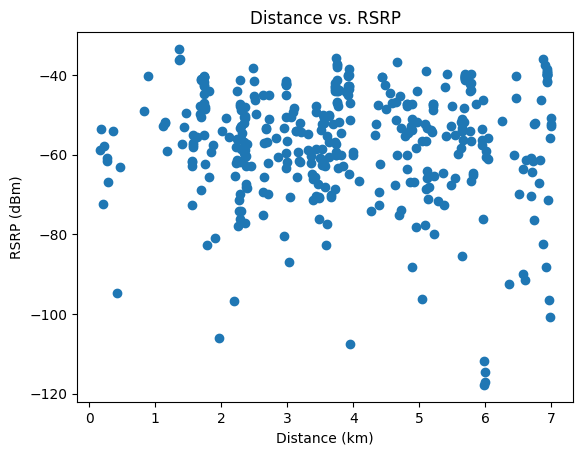

In [46]:
# I have plotted measurements vs km plot
import matplotlib.pyplot as plt

# Create a scatter plot of distance vs. rsrp_top1_o2
plt.scatter(distances_dfg['distance'], distances_dfg['rsrp_top1_o2'])

# Set the title and labels for the plot
plt.title('Distance vs. RSRP')
plt.xlabel('Distance (km)')
plt.ylabel('RSRP (dBm)')

# Show the plot
plt.show()

Now Lets plot for all the cells

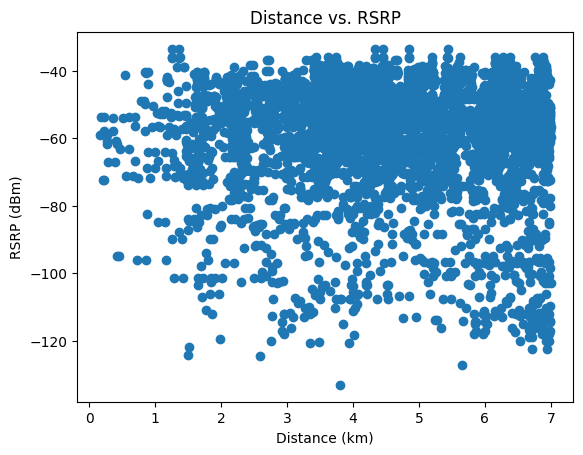

In [47]:
# Create a scatter plot of distance vs. rsrp_top1_o2
plt.scatter(distances_df['distance'], distances_df['rsrp_top1_o2'])

# Set the title and labels for the plot
plt.title('Distance vs. RSRP')
plt.xlabel('Distance (km)')
plt.ylabel('RSRP (dBm)')

# Show the plot
plt.show()

**Analysis:** This plot suggests that there is no direct relationship between distance of cell and RSRP value, reason is area covered by cell towers is overlaping so if a measurement is away from one cell then there is chance that it is near to some other cell. Moreover obstecles may also influencing the coverage of a cell tower.

In [50]:
# Range of LTE cell tower is typically 6 to 7 KM. To confirm our above analysis lets plot a circule around cell tower's with radius
# 7km to check either coverage areas are overlaping or not
import numpy as np
from folium.plugins import HeatMap

# Defining the center of the map
center_lat = np.mean([np.max(distances_df['cell_lat']), np.min(distances_df['cell_lat'])])
center_lon = np.mean([np.max(distances_df['cell_lon']), np.min(distances_df['cell_lon'])])

# Creating the map object
m = folium.Map(location=[center_lat, center_lon], zoom_start=6)

# Creating a marker cluster for cell towers
tower_cluster = MarkerCluster(name='Cell Towers').add_to(m)

# creating a color scale for the rsrp_top1_o2 values
colormap = linear.RdYlBu_09.scale(vmin=distances_df['rsrp_top1_o2'].min(), vmax=distances_df['rsrp_top1_o2'].max())

# Adding cell tower markers to the cluster and droping duplicate (as we have 1 to many relationship between cell tower and rsrp
# measurement locations
for index, row in distances_df.drop_duplicates(subset=['cell_lat', 'cell_lon']).iterrows():
    folium.Marker(location=[row['cell_lat'], row['cell_lon']],
                  tooltip='Cell Tower').add_to(tower_cluster)
    
    # Add circle to the map to show coverage range of cell tower
    folium.Circle(location=[row['cell_lat'], row['cell_lon']],
                  radius=7000,
                  color='blue',
                  fill=False,
                  opacity=0.6,
                  tooltip='7km radius').add_to(m)

# Adding heat map of RSRP measurements to the map
HeatMap(data=distances_df[['measurement_lat', 'measurement_lon', 'rsrp_top1_o2']].values.tolist(), 
        name='RSRP Measurements', 
        radius=10, 
        blur=5).add_to(m)

# Adding a layer control to the map
folium.LayerControl().add_to(m)
# adding the color scale to the map
colormap.caption = 'RSRP Top1 O2'
colormap.add_to(m)
# Display the map
m


In [ ]:
distances_df

In [59]:
# Number of measurements which we want to plot per cell
num_of_measurements = 20
# create map centered on the first cell tower
map_circles = folium.Map(location=[distances_df.cell_lat.iloc[0], distances_df.cell_lon.iloc[0]], zoom_start=10)

# add cell tower locations to the map
for index, row in distances_df.drop_duplicates(subset=['cell_lat', 'cell_lon']).iterrows():
    folium.Marker(location=[row['cell_lat'], row['cell_lon']],
                  icon=folium.Icon(color='red')).add_to(map_circles)
    
    # Add circle to the map to show coverage range of cell tower
    folium.Circle(location=[row['cell_lat'], row['cell_lon']],
                  radius=7000,
                  color='blue',
                  fill=False,
                  opacity=0.6,
                  tooltip='7km radius').add_to(map_circles)
    mesurements = distances_df[(distances_df['cell_lat'] == row['cell_lat'])& (distances_df['cell_lon'] == row['cell_lon'])]
    
    for index, row in mesurements.head(num_of_measurements).iterrows():
        # add RSRP locations and values to the map
        folium.Marker(location=[row.measurement_lat, row.measurement_lon],
                      icon=folium.Icon(color='blue'), tooltip=f"RSRP: {row.rsrp_top1_o2}").add_to(map_circles)
# display map
map_circles


# Prediction of RSRP values
Till now we have seen there is no direct relationship between distance and RSRP measurements and also we have found that 
RSRP values have spatial autocorrelation. Based on this analysis we can choose two methods for prediction of RSRP value on 
unsample locations


1. **Method 1:** Select k number of measurements near the location were we want to predict RSRP value.Take mean of rsrp 
                 values of those locations and that will be our prediction.
2. **Method 2:** Kriging, it is a technique which is used for predicting values on unsampled locations. Kriging
                 uses data's spatial autocorrelation as basic its basic working principle. 
                 I don't know in depth working kriging but according to my finding it basically fits a model on input
                 data using variogram.I have tried OrdinaryKriging module fromfrom pykrige.ok package. It gives options 
                 to select different variogram models.In this project i have just tried to experiment with kriging and tried 
                 to found how effect it is in solving problem of this particular project

**Method 1:** Select 5 number of measurements near the randomly selected location.

In [107]:
# Excluding first 500 values from the dataset for using them for testing
df = distances_df[500:].copy()

# Randomly selected a location for testing purpose from excluded values
lat = 51.566496	
lon = -0.18237

# Calculate the distances between randomly location and all the measurements in the df using the Haversine formula
df['distance_from_location'] = df.apply(lambda row: haversine((lat, lon), (row['measurement_lat'], row['measurement_lon'])), axis=1)
df['distance_from_location'] = df['distance_from_location'].drop_duplicates()
# Select the 5 nearest measurements based on the calculated distances
nearest_measurements = df.nsmallest(5, 'distance_from_location')

# Use the selected measurements to predict the RSRP value at the specified location
predicted_rsrp = np.mean(nearest_measurements['rsrp_top1_o2'])

print("The predicted RSRP value:{} and Actual: {}".format(predicted_rsrp),)


The predicted RSRP value at location (51.566496, -0.18237) is -103.54400000000001


In [105]:
nearest_measurements

,cell_lat,cell_lon,measurement_lat,measurement_lon,distance,rsrp_top1_o2,distance_from_location
991,51.516368,-0.157094,51.566496,-0.182371,5.841691,-117.80,0.000058
994,51.516368,-0.157094,51.566497,-0.182372,5.841825,-111.89,0.000186
992,51.516368,-0.157094,51.566680,-0.182450,5.862841,-117.16,0.021204
993,51.516368,-0.157094,51.566718,-0.182465,5.867178,-114.48,0.025549
1167,51.516368,-0.157094,51.563987,-0.180279,5.532448,-56.39,0.314220


**Method 2:*** Kriging, I have tried OrdinaryKriging but i think UniversalKriging might be more effective in this case 
               UniversalKriging assumes there is non-constant trend in the data while OrdinaryKriging assumes trend is constant
               here the word trend means that overall pattern in the values of RSRP

In [110]:
from pykrige.ok import OrdinaryKriging

# Lets split the dataset into two. I am excluding first 500 values and will test the model on those values
set_1 = distances_df[500:]
# Specify the input data
input_data = set_1[['measurement_lat', 'measurement_lon', 'rsrp_top1_o2']].values

# Specify the variogram model
variogram_model = 'exponential'

# Fit the kriging model
OK = OrdinaryKriging(
    input_data[:, 0], input_data[:, 1], input_data[:, 2],
    variogram_model=variogram_model
)

# Its a random value test value not from the dataset
valid_data_x = 51.571569
valid_data_y = -0.194430

z, ss = OK.execute('points', valid_data_x, valid_data_y)
print(z[0])

# This is one of our test values which we excluded from distances_df
valid_data_x = 51.566496
valid_data_y = -0.18237
z, ss = OK.execute('points', valid_data_x, valid_data_y)

print("Predicted Value :{} Actual Value: {}".format(z[0],distances_df[(distances_df['measurement_lat'].round(3) ==51.566)&(distances_df['measurement_lon'].round(3) ==-0.182)]['rsrp_top1_o2'].mean()))



-71.34112078454949
Predicted Value :-99.02977643544781 Actual Value: -114.84500000000001


In [87]:
distances_df.head()

,cell_lat,cell_lon,measurement_lat,measurement_lon,distance,rsrp_top1_o2,distance_from_location
0,51.515082,-0.157364,51.566496,-0.182371,5.972862,-117.80,1.060960
1,51.515082,-0.157364,51.566680,-0.182450,5.994021,-117.16,1.045562
2,51.515082,-0.157364,51.566718,-0.182465,5.998360,-114.48,1.042491
3,51.515082,-0.157364,51.566497,-0.182372,5.972996,-111.89,1.060840
4,51.515082,-0.157364,51.511019,-0.100558,3.956910,-107.57,9.398261


# Conclusion:
In this project we have found follwoing results


    1. There is strong spatial autocorrelation in RSRP measurement values
    2. There is no direct or clear relationship between distance of RSRP measurement location from cell tower and RSRP value
    3. Method 1 is extremely sensitive to number of nearby measurements. 5 or close to 5 number of measurements are giving
       satisfactry results
    4. Error in Kriging is little more as compare to method 1(where 5 measurements are use)
Overall all both the methods are working almost fine but results are not conclusive more extensive testing is required.  

We have seen a good value of Moran's I and also check that its not neccessary that there should be a direct relationship between cell tower distance and signal strength. Based on these two concluding facts we can use Kriging to predict value of RSRP around the are area where measurement is taken 

In [ ]:
""""
# This cell cause crash because of excessive usage of RAM (This Cell shows measurement locations on a map)
import folium
from folium.plugins import MarkerCluster
import pandas as pd

# Read in the CSV file
df = pd.read_csv('updated_lte.csv')

# Create a map object with center coordinates
m = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=10)

# Create marker clusters for each network's measurements
mc_3uk = MarkerCluster()
mc_ee = MarkerCluster()
mc_o2 = MarkerCluster()
mc_vf = MarkerCluster()

# Add markers for each network's measurements to respective marker cluster
for idx, row in df.iterrows():
    if not pd.isna(row['rsrp_top1_3uk']):
        mc_3uk.add_child(folium.Marker(location=[row['latitude'], row['longitude']], popup=f"RSRP: {row['rsrp_top1_3uk']}"))
    if not pd.isna(row['rsrp_top1_ee']):
        mc_ee.add_child(folium.Marker(location=[row['latitude'], row['longitude']], popup=f"RSRP: {row['rsrp_top1_ee']}"))
    if not pd.isna(row['rsrp_top1_o2']):
        mc_o2.add_child(folium.Marker(location=[row['latitude'], row['longitude']], popup=f"RSRP: {row['rsrp_top1_o2']}"))
    if not pd.isna(row['rsrp_top1_vf']):
        mc_vf.add_child(folium.Marker(location=[row['latitude'], row['longitude']], popup=f"RSRP: {row['rsrp_top1_vf']}"))

# Add marker clusters to the map object
m.add_child(mc_3uk)
m.add_child(mc_ee)
m.add_child(mc_o2)
m.add_child(mc_vf)

# Display the map
m
"""